# Understanding!

In [ ]:
Understanding a Method
- Read the manual
- Adjust one parameter at the time

Understanding the Performance
- Repeat analysis to see variation in performance and parameters
- Repeat using random subsets (if the method is not already stochastic)

Understanding what the method is doing on your data:
- Possibly: See parameter weights (e.g. in LDA) but remember to consider parameter scaling
- Possibly: See which parameters are used (e.g. in RF)
- Try SHAP (read the manual!!)

## Prepare

In [ ]:
# set working directory 
%cd "/Users/erikdam/Dropbox (DIKU)/DataScienceLab/MLIM2019/Thursday"

In [1]:
# Preparing Knee MRI and Pain data

import numpy as np
import h5py 

f = h5py.File('PairedMarkers.mat','r') 
markers = np.array(f.get('markers'))
pain = np.array(f.get('pain'))
markerTags = []
for column in f['markerTags']:
    row_data = []
    for row_number in range(len(column)):            
        row_data.append(''.join(map(chr, f[column[row_number]][:])))   
    markerTags.append(row_data[0])
    
# Separate MRI markers from the Xray markers and remove NaN entries
mri = markers[:-2,:,:]
mriTags = markerTags[:-2]
nanPain = np.max(np.isnan(pain), axis=0)
nanMRI = np.max(np.max(np.isnan(mri), axis=0), axis=0)
ok = ~nanMRI & ~nanPain

# Look at left-right differences
inVars = mri[:,1,ok].T - mri[:,0,ok].T
outcome = pain[1,ok] - pain[0,ok]


## Repeat 

In [6]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_predict
import sklearn.metrics as skm
import numpy as np

repeats = 10
r2 = np.zeros(repeats)
mad = np.zeros(repeats)

model = LinearRegression()
for i in range(repeats):
    pred = cross_val_predict(model, inVars, outcome, cv=20)
    r2[i] = skm.r2_score(outcome, pred)
    print(' %d: %.6f' % (i,skm.r2_score(outcome, pred)))
print('R2 , mean %.2f, min %.2f, max %.2f, std %.2f' % (np.mean(r2), np.min(r2), np.max(r2), np.std(r2)))

 0: 0.136260
 1: 0.136260
 2: 0.136260
 3: 0.136260
 4: 0.136260
 5: 0.136260
 6: 0.136260
 7: 0.136260
 8: 0.136260
 9: 0.136260
R2 , mean 0.14, min 0.14, max 0.14, std 0.00


In [ ]:
Exercise: What is the variation in performance for a Random Forest regressor?

In [9]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_predict
import sklearn.metrics as skm
import numpy as np

repeats = 10
r2 = np.zeros(repeats)
mad = np.zeros(repeats)

model = RandomForestRegressor(n_estimators=50, max_features='sqrt', max_depth=10) # with default features
for i in range(repeats):
    pred = cross_val_predict(model, inVars, outcome, cv=5)
    r2[i] = skm.r2_score(outcome, pred)
    print(' %d: %.6f' % (i,skm.r2_score(outcome, pred)))
print('R2 , mean %.2f, min %.2f, max %.2f, std %.2f' % (np.mean(r2), np.min(r2), np.max(r2), np.std(r2)))

 0: 0.125859
 1: 0.120171
 2: 0.130224
 3: 0.122353
 4: 0.125290
 5: 0.124834
 6: 0.125475
 7: 0.127524
 8: 0.126692
 9: 0.129501
R2 , mean 0.13, min 0.12, max 0.13, std 0.00


Note: sklearn.model_selection.cross_validate has parameter return_estimator that allows inspection of model parameters

## SHAP

In [12]:
# Try SHAP (SHapley Additive exPlanations)
# https://github.com/slundberg/shap/blob/master/README.md
#conda install -c conda-forge shap
#pip install shap
import shap
# load JS visualization code to notebook
shap.initjs()

In [13]:
model = LinearRegression()
model.fit(inVars, outcome)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [14]:
# Explain the model's predictions using SHAP values
# (same syntax works for LightGBM, CatBoost, and scikit-learn models)
explainer = shap.LinearExplainer(model, inVars)
shap_values = explainer.shap_values(inVars)

D:\sofatware\anaconda\lib\site-packages\shap\explainers\linear.py:47: UserWarning: The default value for feature_dependence has been changed to "independent"!
  warnings.warn('The default value for feature_dependence has been changed to "independent"!')


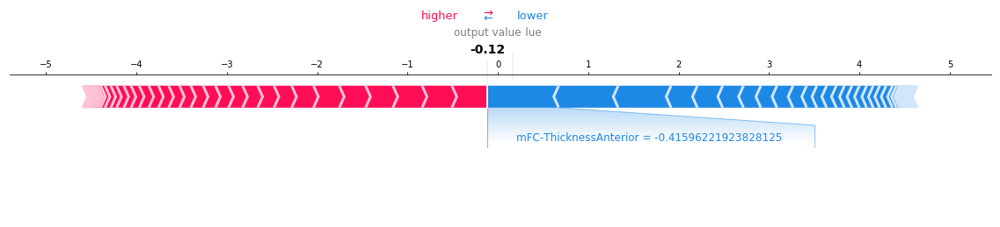

In [15]:
# Visualize the first samples prediction explanation (use matplotlib=True to avoid Javascript)
shap.force_plot(explainer.expected_value, shap_values[0,:], inVars[0,:], matplotlib=True, feature_names=mriTags)

In [16]:
# Visualize the predictions explanations for all
shap.force_plot(explainer.expected_value, shap_values, inVars)

D:\sofatware\anaconda\lib\site-packages\shap\plots\force.py:111: UserWarning: shap.force_plot is slow many thousands of rows, try subsampling your data.
  warnings.warn("shap.force_plot is slow many thousands of rows, try subsampling your data.")


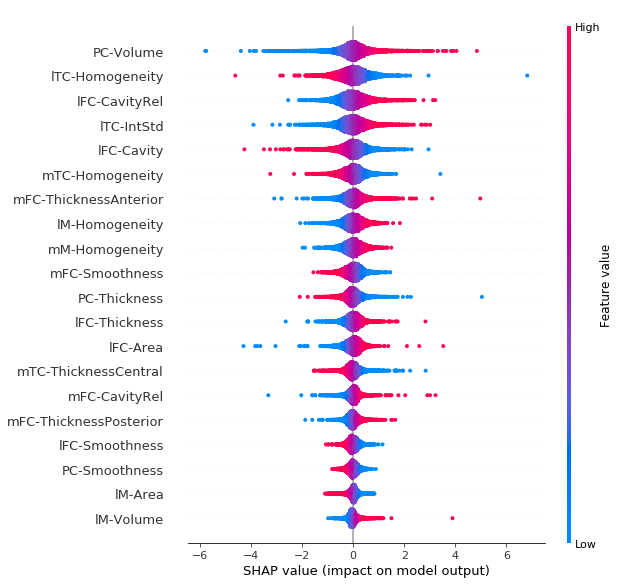

In [17]:
# Summarize the effects of all the features
shap.summary_plot(shap_values, inVars, feature_names=mriTags)